# Optic disc detection using YOLO

In [3]:
from ultralytics import YOLO
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from tqdm import tqdm

In [2]:
def show_optic_disc_shapes(model, image_dir, image_numbers, conf=0.25, cols=5, figsize=(20, 10)):
    """
    Predicts segmentation masks for multiple images and displays
    the exact predicted mask contours (borders) for each image.

    Args:
        model: YOLO segmentation model (e.g., YOLOv11)
        image_dir: directory containing input images
        image_numbers: list of image numbers (e.g., [1, 2, 3])
        conf: confidence threshold for predictions
        cols: number of columns in the subplot grid
        figsize: overall figure size
    """
    image_dir = Path(image_dir)
    rows = int(np.ceil(len(image_numbers) / cols))
    plt.figure(figsize=figsize)

    for i, num in enumerate(image_numbers):
        filename = f"{num:04d}.png"
        img_path = image_dir / filename

        # Run prediction
        results = model.predict(source=str(img_path), conf=conf, verbose=False, show=False, save=False)
        if not results or results[0].masks is None:
            print(f"[Warning] No mask found in {filename}")
            continue

        # Read image
        img = cv2.imread(str(img_path))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        overlay = img.copy()

        # Draw all predicted mask contours
        for mask_xy in results[0].masks.xy:
            contour = mask_xy.astype(np.int32)
            cv2.polylines(overlay, [contour], isClosed=True, color=(0, 255, 0), thickness=2)

        # 2. Draw Ellipse inside Bounding Box (Red)
        if results[0].boxes is not None:
            # We use xywh (x_center, y_center, width, height)
            # .cpu().numpy() ensures we can work with the data outside of tensors
            boxes_xywh = results[0].boxes.xywh.cpu().numpy()

            for box in boxes_xywh:
                x_c, y_c, w, h = box

                # Center of the ellipse
                center = (int(x_c), int(y_c))

                # Axes: OpenCV expects radii (half of width/height)
                axes = (int(w / 2), int(h / 2))

                # Draw the ellipse
                # angle=0 (no rotation), startAngle=0, endAngle=360
                # Color (255, 0, 0) is Red in RGB
                cv2.ellipse(overlay, center, axes, 0, 0, 360, (255, 0, 0), 2)

        # Blend overlay for nicer visualization
        blended = cv2.addWeighted(img, 0.7, overlay, 0.3, 0)

        # Plot
        plt.subplot(rows, cols, i + 1)
        plt.imshow(blended)
        plt.title(filename)
        plt.axis("off")

    plt.tight_layout()
    plt.show()

[Warning] No mask found in 0736.png
[Warning] No mask found in 0737.png
[Warning] No mask found in 0738.png


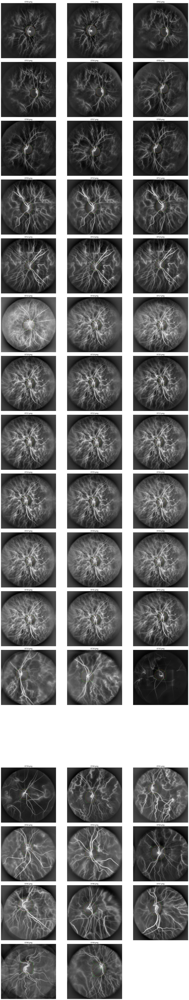

In [3]:
trained_model = YOLO("runs/train/optic_disc_segmentation2/weights/best.pt")
show_optic_disc_shapes(trained_model, "data/optic_disc/train", image_numbers=range(700, 750), cols=3, figsize=(20, 100))

In [6]:
def get_polygon_from_txt(txt_path, img_w, img_h):
    """
    Reads a YOLO format txt file and converts normalized coordinates
    to absolute pixel coordinates.
    """
    try:
        with open(txt_path, 'r') as f:
            lines = f.readlines()
    except FileNotFoundError:
        return None

    polygons = []
    for line in lines:
        data = list(map(float, line.strip().split()))
        # data[0] is class_id, skip it
        coords = data[1:]

        poly = []
        for i in range(0, len(coords), 2):
            x = int(coords[i] * img_w)
            y = int(coords[i+1] * img_h)
            poly.append([x, y])
        polygons.append(np.array(poly, np.int32))

    return polygons

def calculate_mask_dice(gt_polys, pred_masks, img_h, img_w):
    """
    Calculates Dice Coefficient between Ground Truth polygons and Predicted masks.
    Formula: 2 * Intersection / (Area_GT + Area_Pred)
    """
    # 1. Create blank binary masks
    mask_gt = np.zeros((img_h, img_w), dtype=np.uint8)
    mask_pred = np.zeros((img_h, img_w), dtype=np.uint8)

    # 2. Draw Ground Truth
    if gt_polys:
        cv2.fillPoly(mask_gt, gt_polys, 1)

    # 3. Draw Prediction
    if pred_masks is not None:
        for xy in pred_masks.xy:
            if len(xy) > 0:
                contour = xy.astype(np.int32)
                cv2.fillPoly(mask_pred, [contour], 1)

    # 4. Calculate Dice
    intersection = np.logical_and(mask_gt, mask_pred).sum()
    area_gt = mask_gt.sum()
    area_pred = mask_pred.sum()

    total_area = area_gt + area_pred

    if total_area == 0:
        # Both masks are empty, technically a perfect match (no object present and none detected)
        return 1.0

    dice_score = (2 * intersection) / total_area
    return dice_score

def show_worst_predictions(model, image_dir, label_dir, search_range, num_worst=50, cols=5, figsize=(20, 100)):
    image_dir = Path(image_dir)
    label_dir = Path(label_dir)

    scored_results = []

    print(f"Comparing predictions vs Ground Truth (Dice Score) for {len(search_range)} images...")

    # --- 1. SCAN AND SCORE ---
    for num in tqdm(search_range):
        filename_img = f"{num:04d}.png"
        filename_txt = f"{num:04d}.txt"

        img_path = image_dir / filename_img
        txt_path = label_dir / filename_txt

        if not img_path.exists():
            continue

        img0 = cv2.imread(str(img_path))
        if img0 is None: continue
        h, w = img0.shape[:2]

        gt_polys = get_polygon_from_txt(txt_path, w, h)

        results = model.predict(source=str(img_path), verbose=False, save=False)
        pred_masks = results[0].masks

        # If GT file is missing, we skip
        if gt_polys is None:
            continue

        dice = calculate_mask_dice(gt_polys, pred_masks, h, w)
        scored_results.append((dice, filename_img, img_path, gt_polys))

    # --- 2. SORT (Lowest Dice = Worst) ---
    scored_results.sort(key=lambda x: x[0])
    worst_images = scored_results[:num_worst]

    # --- 3. VISUALIZE ---
    print(f"Displaying {len(worst_images)} worst predictions based on Dice Coefficient...")

    rows = int(np.ceil(len(worst_images) / cols))
    plt.figure(figsize=figsize)

    for i, (dice, filename, img_path, gt_polys) in enumerate(worst_images):

        # Re-predict for visualization
        results = model.predict(source=str(img_path), verbose=False, save=False)

        img = cv2.imread(str(img_path))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        overlay = img.copy()

        # A. Draw GROUND TRUTH in BLUE (0, 0, 255)
        if gt_polys:
            cv2.polylines(overlay, gt_polys, isClosed=True, color=(0, 0, 255), thickness=3)

        # B. Draw PREDICTION in GREEN (0, 255, 0)
        if results[0].masks is not None:
            for mask_xy in results[0].masks.xy:
                if len(mask_xy) > 0:
                    contour = mask_xy.astype(np.int32)
                    cv2.polylines(overlay, [contour], isClosed=True, color=(0, 255, 0), thickness=2)

        blended = cv2.addWeighted(img, 0.6, overlay, 0.4, 0)

        plt.subplot(rows, cols, i + 1)
        plt.imshow(blended)
        plt.title(f"{filename}\nDice: {dice:.2f}")
        plt.axis("off")

        if i == 0:
            plt.xlabel("Blue: Ground Truth\nGreen: Prediction")

    plt.tight_layout()
    plt.show()

Comparing predictions vs Ground Truth (Dice Score) for 805 images...


100%|██████████| 805/805 [00:42<00:00, 18.92it/s]


Displaying 50 worst predictions based on Dice Coefficient...


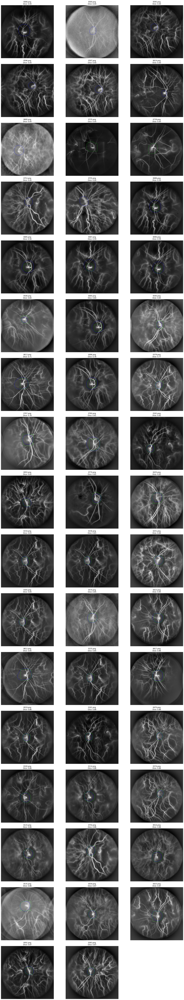

In [6]:
trained_model = YOLO("runs/train/optic_disc_segmentation2/weights/best.pt")

show_worst_predictions(
    trained_model,
    image_dir="data/optic_disc/train",
    label_dir="data/optic_disc/labels",
    search_range=range(1, 806),
    num_worst=50,
    cols=3,
    figsize=(20, 100)
)

In [14]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from pathlib import Path

def pred_optic_disc(
    model,
    image_dir_path,
    label_dir_path,
    images,
    figsize=(10, 10),
    save_image=None,
    WIDTH=4,
    pred=True,
    zoom=True # New parameter
):
    image_dir_path = Path(image_dir_path)
    label_dir_path = Path(label_dir_path)

    fig, axes = plt.subplots(2, 4, figsize=figsize)
    axes = axes.flatten()

    plt.subplots_adjust(left=0, right=1, top=1, bottom=0, wspace=0, hspace=0)

    for i, image in enumerate(images):
        filename_img = f"{image:04d}.png"
        filename_txt = f"{image:04d}.txt"

        img_path = image_dir_path / filename_img
        txt_path = label_dir_path / filename_txt

        results = model.predict(source=str(img_path), verbose=False, save=False)

        img = cv2.imread(str(img_path))
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        h, w = img.shape[:2]
        overlay = img.copy()

        center_x, center_y = w // 2, h // 2  # Default center if no detection

        if pred:
            # Prediction masks (Green)
            if results[0].masks is not None:
                for mask_xy in results[0].masks.xy:
                    contour = mask_xy.astype(np.int32)
                    cv2.polylines(overlay, [contour], True, (0, 255, 0), WIDTH)

            # Ground truth (Blue)
            gt_polys = get_polygon_from_txt(txt_path, w, h)
            if gt_polys:
                cv2.polylines(overlay, gt_polys, True, (20, 20, 255), WIDTH)

            # Ellipses (Red)
            if results[0].boxes is not None and len(results[0].boxes) > 0:
                boxes = results[0].boxes.xywh.cpu().numpy()
                # We take the first detection to center the zoom
                center_x, center_y, bw, bh = boxes[0]

                for x_c, y_c, bw, bh in boxes:
                    center = (int(x_c), int(y_c))
                    axes_ = (int(bw / 2), int(bh / 2))
                    cv2.ellipse(overlay, center, axes_, 0, 0, 360, (255, 0, 0), WIDTH)

        blended = cv2.addWeighted(img, 0.3, overlay, 0.7, 0)

        # --- ZOOM LOGIC START ---
        if zoom:
            # 25% area means 50% width and 50% height
            zoom_w = int(w * 0.5)
            zoom_h = int(h * 0.5)

            # Calculate top-left corner coordinates
            x1 = int(center_x - zoom_w // 2)
            y1 = int(center_y - zoom_h // 2)

            # Adjust coordinates to keep the crop inside image boundaries
            x1 = max(0, min(x1, w - zoom_w))
            y1 = max(0, min(y1, h - zoom_h))
            x2 = x1 + zoom_w
            y2 = y1 + zoom_h

            # Crop the blended image
            display_img = blended[y1:y2, x1:x2]
        else:
            display_img = blended
        # --- ZOOM LOGIC END ---

        axes[i].imshow(display_img, aspect="auto")
        axes[i].axis("off")

    if save_image is not None:
        fig.savefig(
            save_image,
            dpi=300,
            bbox_inches="tight",
            pad_inches=0,
            facecolor="none"
        )

    plt.show()
    plt.close(fig)

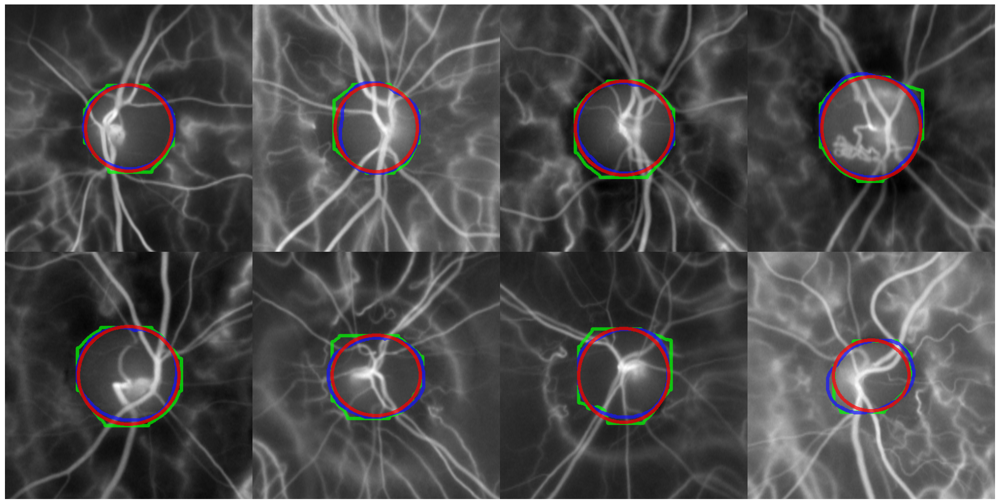

In [15]:
trained_model = YOLO("runs/train/optic_disc_segmentation2/weights/best.pt")
pred_optic_disc(
    trained_model,
    "data/optic_disc/train/",
    "data/optic_disc/labels/",
    images=[316, 500, 506, 519, 526, 546, 547, 562],
    figsize=(20,10),
    save_image="C:/Users/Domodekavkaz/Desktop/images/out/out1.png",
    WIDTH=6,
    pred=True,
)

In [20]:
import numpy as np
import cv2
from pathlib import Path
from tqdm import tqdm
from ultralytics import YOLO

def get_gt_mask(txt_path, width, height):
    """Converts YOLO format GT txt file to a binary mask."""
    mask = np.zeros((height, width), dtype=np.uint8)
    if not txt_path.exists():
        return mask

    with open(txt_path, 'r') as f:
        for line in f:
            # YOLO format: class x_center y_center width height (normalized)
            # OR class x1 y1 x2 y2 ... (for segmentation)
            data = list(map(float, line.strip().split()))
            coords = np.array(data[1:])
            poly = coords.reshape(-1, 2)
            poly[:, 0] *= width
            poly[:, 1] *= height
            cv2.fillPoly(mask, [poly.astype(np.int32)], 1)
    return mask

def get_ellipse_mask(box, orig_w, orig_h):
    """
    Generates the binary mask M described in Section 2.4.
    Uses the predicted bounding box to create a geometric ellipse.
    """
    mask = np.zeros((orig_h, orig_w), dtype=np.uint8)

    # xywh are usually in original image coordinates in results.boxes
    cx, cy, bw, bh = box

    center = (int(cx), int(cy))
    axes = (int(bw / 2), int(bh / 2))

    # Draw a filled white ellipse (1) on black background (0)
    cv2.ellipse(mask, center, axes, 0, 0, 360, 1, thickness=-1)
    return mask

def compute_metrics(pd_mask, gt_mask):
    """Calculates IoU and Dice Coefficient."""
    intersection = np.logical_and(pd_mask, gt_mask).sum()
    union = np.logical_or(pd_mask, gt_mask).sum()

    if union == 0:
        return 1.0, 1.0 if pd_mask.sum() == 0 else 0.0

    iou = intersection / union
    dice = (2 * intersection) / (pd_mask.sum() + gt_mask.sum())
    return iou, dice

def evaluate_ellipse_performance(model_path, img_dir, label_dir):
    model = YOLO(model_path)
    img_dir = Path(img_dir)
    label_dir = Path(label_dir)

    img_files = list(img_dir.glob("*.png"))

    iou_scores = []
    dice_scores = []
    failures = 0

    print(f"Evaluating Ellipse Fit Performance on {len(img_files)} images...")

    for img_path in tqdm(img_files):
        # 1. Load Image and Ground Truth
        img = cv2.imread(str(img_path))
        h, w = img.shape[:2]
        txt_path = label_dir / (img_path.stem + ".txt")
        gt_mask = get_gt_mask(txt_path, w, h)

        # 2. Run Inference
        results = model.predict(source=str(img_path), verbose=False)[0]

        # 3. Create Ellipse Mask from Bounding Box
        if results.boxes is not None and len(results.boxes) > 0:
            # Get the box with the highest confidence
            # .xywh provides coordinates in original image pixels
            best_box = results.boxes[0].xywh.cpu().numpy()[0]
            ellipse_mask = get_ellipse_mask(best_box, w, h)
        else:
            # No detection = empty mask
            ellipse_mask = np.zeros((h, w), dtype=np.uint8)

        # 4. Calculate Metrics
        iou, dice = compute_metrics(ellipse_mask, gt_mask)
        iou_scores.append(iou)
        dice_scores.append(dice)

        if iou < 0.5:
            failures += 1

    # Final Summary
    print("\n" + "="*40)
    print(" SECTION 3.1: ELLIPSE SEGMENTATION ")
    print("="*40)
    print(f"Mean IoU:  {np.mean(iou_scores):.4f} ± {np.std(iou_scores):.4f}")
    print(f"Mean Dice: {np.mean(dice_scores):.4f} ± {np.std(dice_scores):.4f}")
    print(f"Failure Rate (IoU < 0.5): {failures/len(img_files)*100:.2f}%")
    print(f"Total Images (n): {len(img_files)}")
    print("="*40)

# --- EXECUTION ---
evaluate_ellipse_performance(
    model_path="runs/train/optic_disc_segmentation2/weights/best.pt",
    img_dir="data/optic_disc/train",
    label_dir="data/optic_disc/labels"
)

Evaluating Ellipse Fit Performance on 805 images...


100%|██████████| 805/805 [00:42<00:00, 18.81it/s]


 SECTION 3.1: ELLIPSE SEGMENTATION 
Mean IoU:  0.8765 ± 0.1269
Mean Dice: 0.9262 ± 0.1202
Failure Rate (IoU < 0.5): 2.24%
Total Images (n): 805


In [21]:
import numpy as np
from pathlib import Path
from tqdm import tqdm
from ultralytics import YOLO
import cv2

def generate_table_metrics(model_path, img_dir, L_disc_prior=1.92):
    model = YOLO(model_path)
    img_dir = Path(img_dir)
    img_files = list(img_dir.glob("*.png"))

    # Storage for metrics
    l_disc_px = []
    p_disc_um = []
    L_x_mm = []
    L_y_mm = []

    print(f"Processing {len(img_files)} images for calibration metrics...")

    for img_path in tqdm(img_files):
        # 1. Load original dimensions
        img = cv2.imread(str(img_path))
        orig_h, orig_w = img.shape[:2]

        # 2. Inference
        results = model.predict(source=str(img_path), verbose=False)[0]

        # 3. Calculation (Only if a box is detected)
        if results.boxes is not None and len(results.boxes) > 0:
            # We take the detection with highest confidence
            box = results.boxes[0].xywh.cpu().numpy()[0]
            _, _, bw, bh = box # these are in pixels relative to the inference size (e.g. 1024)

            # Scale box back to original image size
            # YOLO xywh output is based on the input size used for inference
            scale_x = orig_w / 1024
            scale_y = orig_h / 1024
            bw_orig = bw * scale_x
            bh_orig = bh * scale_y

            # Equation 3: Major axis of the ellipse
            ell_disc = max(bw_orig, bh_orig)

            # Equation 4: Pixel pitch (mm/px)
            P_disc_mm = L_disc_prior / ell_disc

            # Equation 5: Lateral Extent
            Lx = orig_w * P_disc_mm
            Ly = orig_h * P_disc_mm

            # Store results
            l_disc_px.append(ell_disc)
            p_disc_um.append(P_disc_mm * 1000) # Convert to micrometers
            L_x_mm.append(Lx)
            L_y_mm.append(Ly)

    # 4. Compute Statistics Function
    def get_stats(data):
        mean = np.mean(data)
        sd = np.std(data)
        cov = (sd / mean) * 100
        return mean, sd, cov

    metrics = {
        "l_disc": get_stats(l_disc_px),
        "p_disc": get_stats(p_disc_um),
        "Lx": get_stats(L_x_mm),
        "Ly": get_stats(L_y_mm)
    }

    # Print Table
    print("\n" + "="*50)
    print(f"{'Metric':<20} | {'Mean':<10} | {'SD':<10} | {'CoV (%)':<10}")
    print("-" * 50)
    for key, (m, s, c) in metrics.items():
        print(f"{key:<20} | {m:<10.2f} | {s:<10.2f} | {c:<10.2f}")
    print(f"\nTotal processed (n): {len(l_disc_px)}")
    print("="*50)

# Run it
generate_table_metrics(
    model_path="runs/train/optic_disc_segmentation2/weights/best.pt",
    img_dir="data/optic_disc/train"
)

Processing 805 images for calibration metrics...


100%|██████████| 805/805 [00:42<00:00, 18.86it/s]


Metric               | Mean       | SD         | CoV (%)   
--------------------------------------------------
l_disc               | 195.46     | 24.34      | 12.45     
p_disc               | 9.99       | 1.40       | 13.98     
Lx                   | 10.22      | 1.43       | 13.98     
Ly                   | 10.22      | 1.43       | 13.98     

Total processed (n): 790


In [23]:
import numpy as np
from pathlib import Path
from tqdm import tqdm
from ultralytics import YOLO

def analyze_vh_ratio(model_path, img_dir):
    model = YOLO(model_path)
    img_dir = Path(img_dir)
    img_files = list(img_dir.glob("*.png"))

    vh_ratios = []

    print(f"Analyzing V/H ratios for {len(img_files)} images...")

    for img_path in tqdm(img_files):
        # Run inference
        results = model.predict(source=str(img_path), verbose=False)[0]

        if results.boxes is not None and len(results.boxes) > 0:
            # results.boxes.xywh contains [center_x, center_y, width, height]
            # Coordinates are in pixels
            box = results.boxes[0].xywh.cpu().numpy()[0]

            bw = box[2] # Width (Horizontal Diameter)
            bh = box[3] # Height (Vertical Diameter)

            if bw > 0: # Avoid division by zero
                ratio = bh / bw
                vh_ratios.append(ratio)

    # Calculate statistics
    if vh_ratios:
        mean_ratio = np.mean(vh_ratios)
        std_ratio = np.std(vh_ratios)

        print("\n" + "="*45)
        print("      OPTIC DISC ANATOMICAL ANALYSIS      ")
        print("="*45)
        print(f"Mean V/H Ratio:     {mean_ratio:.4f} ± {std_ratio:.4f}")
        print(f"Sample size (n):    {len(vh_ratios)}")
        print("-" * 45)

        if mean_ratio > 1.0:
            print(f"Observation: The disc is vertically oval (Height > Width).")
        else:
            print(f"Observation: The disc is horizontally oval (Width > Height).")

        # Compare with Long et al. (typically ~1.05 - 1.10)
        percentage_diff = (mean_ratio - 1.0) * 100
        print(f"Vertical elongation: {percentage_diff:.2f}%")
        print("="*45)
    else:
        print("No detections were made to calculate ratios.")

# --- EXECUTION ---
analyze_vh_ratio(
    model_path="runs/train/optic_disc_segmentation2/weights/best.pt",
    img_dir="data/optic_disc/train"
)

Analyzing V/H ratios for 805 images...


100%|██████████| 805/805 [00:36<00:00, 22.12it/s]


      OPTIC DISC ANATOMICAL ANALYSIS      
Mean V/H Ratio:     1.0138 ± 0.0815
Sample size (n):    790
---------------------------------------------
Observation: The disc is vertically oval (Height > Width).
Vertical elongation: 1.38%
